## 2D Nonlinear Convection

Since we now introduce a variable velocity term, 2D nonlinear convection is represented by the coupled pair of partial differential equations below, where $u$ is the velocity in the $x$ direction and $v$ is the velocity in the $y$ direction:

$$\frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} + v \frac{\partial u}{\partial y} = 0$$

$$\frac{\partial v}{\partial t} + u \frac{\partial v}{\partial x} + v \frac{\partial v}{\partial y} = 0$$

These respectively discretise to:

$$ u_{i,j}^{n+1} = u_{i,j}^n - u_{i,j} \frac{\Delta t}{\Delta x} (u_{i,j}^n-u_{i-1,j}^n) - v_{i,j}^n \frac{\Delta t}{\Delta y} (u_{i,j}^n-u_{i,j-1}^n) $$

$$ v_{i,j}^{n+1} = v_{i,j}^n - u_{i,j} \frac{\Delta t}{\Delta x} (v_{i,j}^n-v_{i-1,j}^n) - v_{i,j}^n \frac{\Delta t}{\Delta y} (v_{i,j}^n-v_{i,j-1}^n) $$

We will use the following initial condition, which is our usual hat function:

$$ u,\ v\ = \begin{cases}\begin{matrix}
2 & \text{for } x,y \in (0.5, 1)\times(0.5,1) \cr
1 & \text{everywhere else}
\end{matrix}\end{cases} $$

And we will have a boundary condition of:

$$ u = 1,\ v = 1 \text{ for } \begin{cases} \begin{matrix}x=0,2\cr y=0,2 \end{matrix}\end{cases} $$

### Grid and Initial Condition

Essentially this is the same as step 5, but now we have an extra array for velocity in the $y$ direction.

Text(0.5, 0.92, 'Initial condition for 2D Nonlinear Convection')

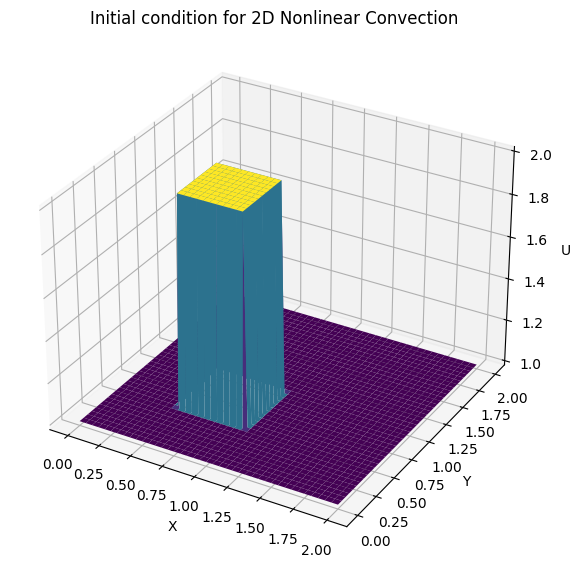

In [1]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from matplotlib import pyplot, cm
%matplotlib inline

#define our 2D grid, and get the time step using CFL condition to ensure convergence
x_len = 2
y_len = 2
num_x = 81
num_y = 81

num_t = 100

sigma = 0.2

del_x = x_len / (num_x - 1)
del_y = y_len / (num_y - 1)
del_t = sigma * del_x

#set x, y, and assign initial conditions for u and v
x = np.linspace(0, x_len, num_x)
y = np.linspace(0, y_len, num_x)

u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

v = np.ones((num_y, num_x))
v[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#plot the initial conditions for u (v is the same)
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
X, Y = np.meshgrid(x, y)
surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('U')
axes.set_title('Initial condition for 2D Nonlinear Convection')

### Solve

$$ u_{i,j}^{n+1} = u_{i,j}^n - u_{i,j} \frac{\Delta t}{\Delta x} (u_{i,j}^n-u_{i-1,j}^n) - v_{i,j}^n \frac{\Delta t}{\Delta y} (u_{i,j}^n-u_{i,j-1}^n) $$

$$ v_{i,j}^{n+1} = v_{i,j}^n - u_{i,j} \frac{\Delta t}{\Delta x} (v_{i,j}^n-v_{i-1,j}^n) - v_{i,j}^n \frac{\Delta t}{\Delta y} (v_{i,j}^n-v_{i,j-1}^n) $$

Text(0.5, 0.92, '2D Nonlinear Convection Solution for U')

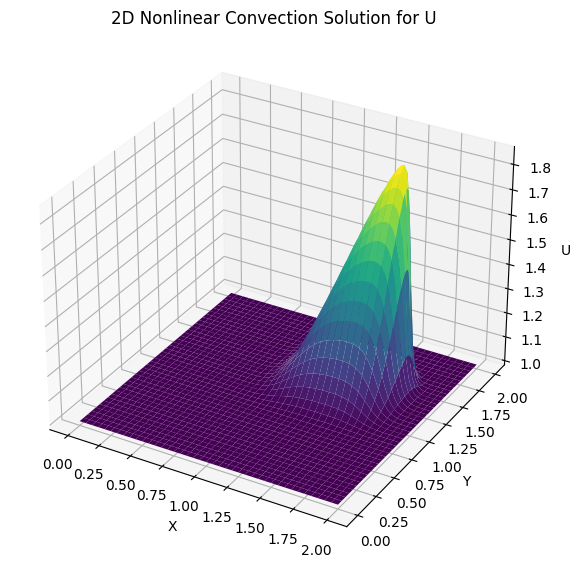

In [2]:
for n in range(num_t + 1):
    u_n = u.copy()
    v_n = v.copy()
    
    #main computation
    u[1: , 1:] = u_n[1: , 1:] - u_n[1: , 1:] * del_t/del_x * (u_n[1: , 1:] - u_n[1: , :-1]) - \
                                u_n[1: , 1:] * del_t/del_y * (u_n[1: , 1:] - u_n[:-1 , 1:])
    
    v[1: , 1:] = v_n[1: , 1:] - v_n[1: , 1:] * del_t/del_x * (v_n[1: , 1:] - v_n[1: , :-1]) - \
                                v_n[1: , 1:] * del_t/del_y * (v_n[1: , 1:] - v_n[:-1 , 1:])
    #set the boundary conditions
    u[0, :] = 1
    u[-1, :] = 1
    u[: , 0] = 1
    u[: , -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[: , 0] = 1
    v[: , -1] = 1
    
    
#plot u in 3d
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
surface2 = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('U')
axes.set_title('2D Nonlinear Convection Solution for U')

Text(0.5, 0.92, '2D Nonlinear Convection Solution for V')

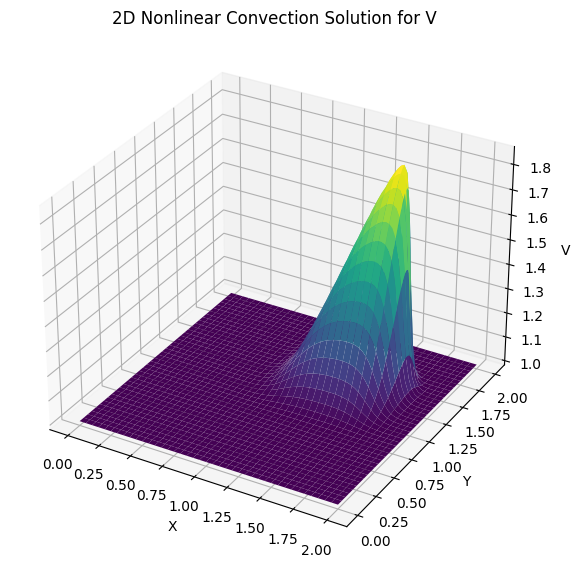

In [3]:
#plot v in 3d
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
surface2 = axes.plot_surface(X, Y, v[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('V')
axes.set_title('2D Nonlinear Convection Solution for V')

### Animate (U Only)

Animation may not display correctly if viewing on Github.

Text(0.5, 0.92, '2D Nonlinear Convection Time Evolution for U')

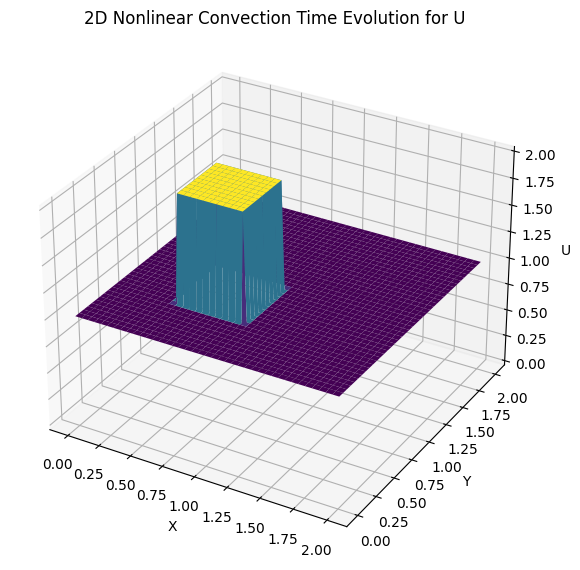

In [4]:
from matplotlib import animation, rc 
from IPython.display import HTML

#reset the initial conditions
u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

v = np.ones((num_y, num_x))
v[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#generate the figure
figure = pyplot.figure(figsize=(11,7), dpi=100)
axes = figure.gca(projection='3d')

surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y');
axes.set_zlabel('U')
axes.set_zlim(0, 2)
axes.set_title('2D Nonlinear Convection Time Evolution for U')

In [5]:
def init_anim():
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
    return surface

def animate(j):
    u_n = u.copy()
    u_v = v.copy()
    
    #main computation
    u[1: , 1:] = u_n[1: , 1:] - u_n[1: , 1:] * del_t/del_x * (u_n[1: , 1:] - u_n[1: , :-1]) - \
                                u_n[1: , 1:] * del_t/del_y * (u_n[1: , 1:] - u_n[:-1 , 1:])
    
    v[1: , 1:] = v_n[1: , 1:] - v_n[1: , 1:] * del_t/del_x * (v_n[1: , 1:] - v_n[1: , :-1]) - \
                                v_n[1: , 1:] * del_t/del_y * (v_n[1: , 1:] - v_n[:-1 , 1:])
    #set the boundary conditions
    u[0, :] = 1
    u[-1, :] = 1
    u[: , 0] = 1
    u[: , -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[: , 0] = 1
    v[: , -1] = 1
    
    #add frame
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
    axes.set_xlabel('X')
    axes.set_ylabel('Y');
    axes.set_zlabel('U')
    axes.set_zlim(0, 2)
    axes.set_title('2D Nonlinear Convection Time Evolution for U')
    return surface

#so that we don't hit the animation embed limit
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

anim = animation.FuncAnimation(figure, animate, init_func=init_anim, frames=num_t, interval=20)
HTML(anim.to_jshtml())